In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import glob
import pickle

from IPython.display import display 
pd.options.display.max_columns = None
pd.options.display.max_rows = None

In [2]:
# with open("./pickle/df0.bin", "rb") as f:
#     df = pickle.load(f)

In [21]:
with open("./pickle/re4_df.bin", "rb") as f:
    df2 = pickle.load(f)

In [22]:
df2.tail()

,pid,weight,images
393,p27img20,122.28,"[[70, 70, 70, 70, 70, 70, 70, 70, 70, 70, 70, ..."
394,p28img01,125.27,"[[107, 107, 107, 107, 107, 107, 107, 107, 107,..."
395,p28img02,127.06,"[[76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, ..."
396,p28img16,121.22,"[[87, 87, 87, 87, 87, 87, 87, 87, 87, 87, 87, ..."
397,p28img19,121.72,"[[74, 74, 74, 74, 74, 74, 74, 74, 74, 74, 74, ..."


In [23]:
df2.images.iloc[-1].shape

(200, 500)

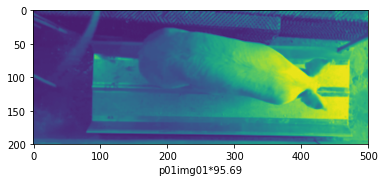

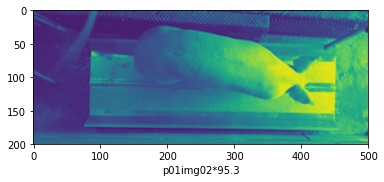

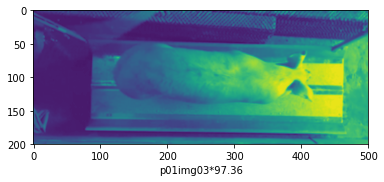

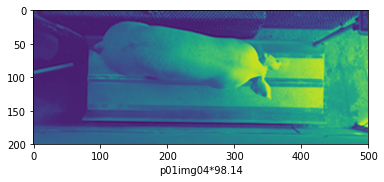

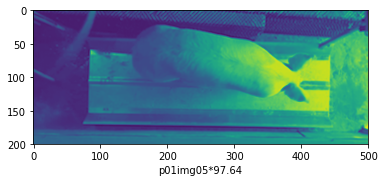

...

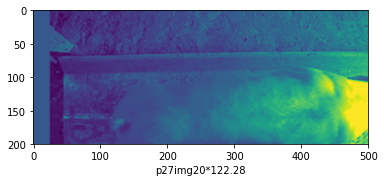

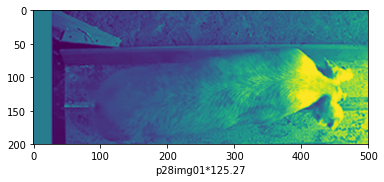

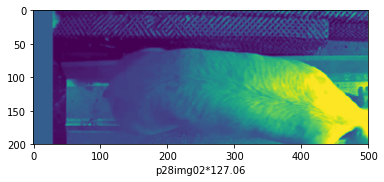

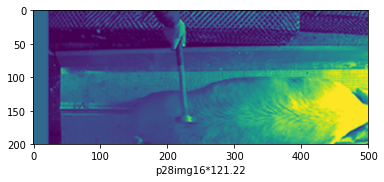

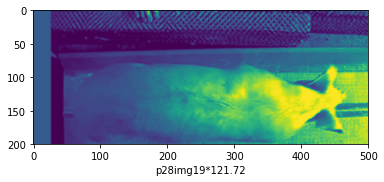

In [25]:
for i in range(len(df2.images)):
    plt.imshow(df2.images[i], interpolation='bicubic')
    plt.xlabel(df2.pid[i]+ '*' +str(df2.weight[i]))
    plt.show()

In [12]:
gray = df2.images.iloc[0]

In [16]:
ret, thresh = cv2.threshold(gray,0,255,cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU)

error: /Users/travis/build/skvark/opencv-python/opencv/modules/imgproc/src/thresh.cpp:1406: error: (-215) src.type() == (((0) & ((1 << 3) - 1)) + (((1)-1) << 3)) in function threshold


In [16]:
# img = cv2.imread('./sample_image/pracimages/resize3/90/p03img17_09135.png',0)
# print(img.shape)
# img

(326, 579)


array([[ 39,  39,  39, ..., 169, 172, 173],
       [ 38,  38,  38, ..., 170, 172, 173],
       [ 38,  38,  38, ..., 171, 172, 173],
       ...,
       [ 79,  79,  79, ..., 121, 124, 124],
       [ 78,  79,  79, ..., 123, 125, 125],
       [ 76,  77,  77, ..., 123, 124, 124]], dtype=uint8)

In [98]:
df2.tail()

,pid,weight,images
393,p27img20,122.28,"[[70, 70, 70, 70, 70, 70, 70, 70, 70, 70, 70, ..."
394,p28img01,125.27,"[[107, 107, 107, 107, 107, 107, 107, 107, 107,..."
395,p28img02,127.06,"[[76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, ..."
396,p28img16,121.22,"[[87, 87, 87, 87, 87, 87, 87, 87, 87, 87, 87, ..."
397,p28img19,121.72,"[[74, 74, 74, 74, 74, 74, 74, 74, 74, 74, 74, ..."


In [104]:
n = np.random.randint(0, len(df2), 1)
print(n[0])
img = df2.images.iloc[n[0]]
print(img)
print(img.shape)

61
[[ 49  42  34 ...  26  30  33]
 [ 69  61  51 ...  26  31  32]
 [ 75  73  71 ...  25  30  32]
 ...
 [ 83  83  83 ... 152 152 153]
 [ 86  86  85 ... 152 152 151]
 [ 86  86  86 ... 149 150 150]]
(200, 500)


In [105]:
img.max()

255

In [106]:
ret,thresh1 = cv2.threshold(img,110,90,cv2.THRESH_BINARY)
ret,thresh2 = cv2.threshold(img,110,255,cv2.THRESH_BINARY_INV)
ret,thresh3 = cv2.threshold(img,110,255,cv2.THRESH_TRUNC)
ret,thresh4 = cv2.threshold(img,110,255,cv2.THRESH_TOZERO)
ret,thresh5 = cv2.threshold(img,110,255,cv2.THRESH_TOZERO_INV)

titles = ['Original Image','BINARY','BINARY_INV','TRUNC','TOZERO','TOZERO_INV']
images = [img, thresh1, thresh2, thresh3, thresh4, thresh5]

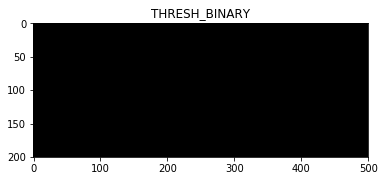

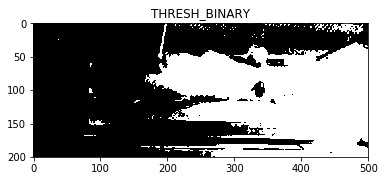

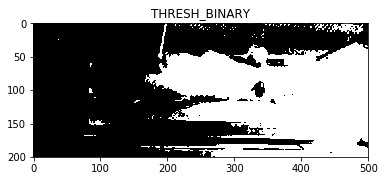

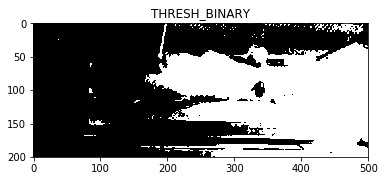

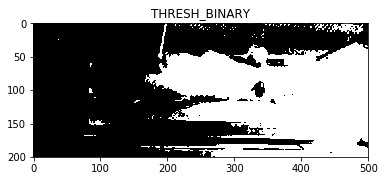

...

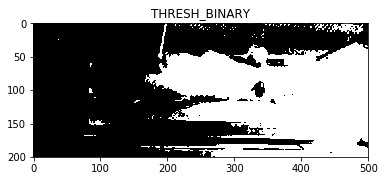

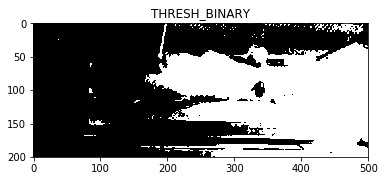

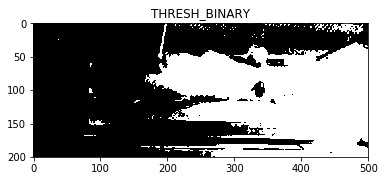

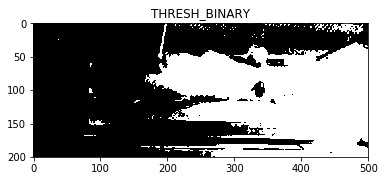

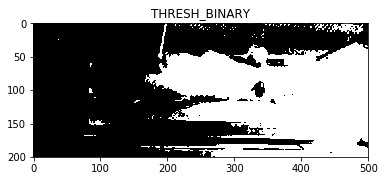

In [107]:
for i in range(20):
    ret, thresh = cv2.threshold(img, 110, i*10, cv2.THRESH_BINARY)
    plt.imshow(thresh, 'gray')
    plt.title('THRESH_BINARY')
    plt.show()

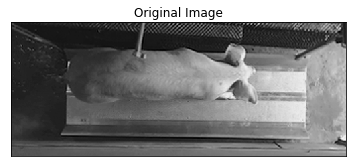

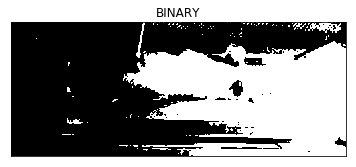

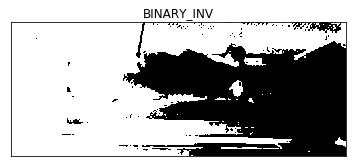

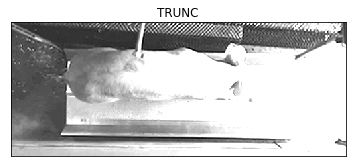

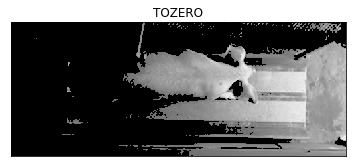

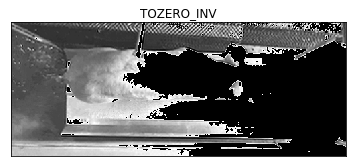

In [108]:
for i in range(6):
    plt.imshow(images[i],'gray')
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([])
    plt.show()

In [121]:
# img = cv2.imread('dave.jpg',0)
laplacian = cv2.Laplacian(img,cv2.CV_64F)
sobelx = cv2.Sobel(img,cv2.CV_64F,1,0,ksize=5)
sobely = cv2.Sobel(img,cv2.CV_64F,0,1,ksize=5)

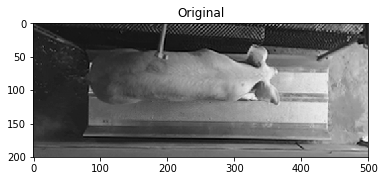

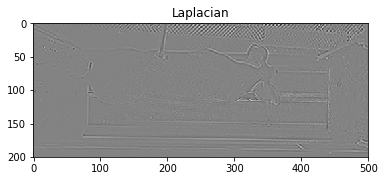

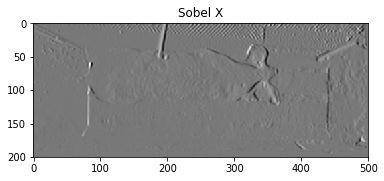

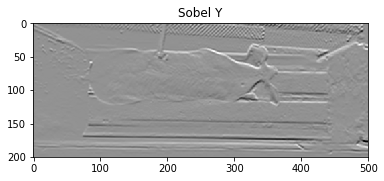

In [122]:
plt.imshow(img,cmap = 'gray')
plt.title('Original')
plt.show()

plt.imshow(laplacian,cmap = 'gray')
plt.title('Laplacian')
plt.show()

plt.imshow(sobelx,cmap = 'gray')
plt.title('Sobel X')
plt.show()

plt.imshow(sobely,cmap = 'gray')
plt.title('Sobel Y')
plt.show()

In [128]:
print(sobely)

[[   0.    0.    0. ...    0.    0.    0.]
 [ 970. 1104. 1324. ...    3.  -32.  -34.]
 [  30.  301.  912. ...   -8.  -64.  -56.]
 ...
 [ 136.  110.   54. ... -226. -257. -274.]
 [ 154.  140.  100. ... -119. -119. -122.]
 [   0.    0.    0. ...    0.    0.    0.]]


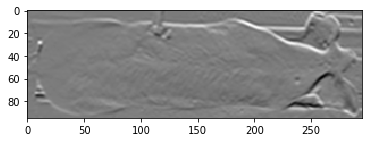

In [139]:
sobely_tmp = sobely[30:125, 75:370]
plt.imshow(sobely_tmp,cmap = 'gray')
plt.show()

In [140]:
sobely_tmp

array([[  33.,   -4.,   -4., ...,  -98., -103., -245.],
       [  75.,   46.,   42., ..., -129., -198., -481.],
       [  60.,   64.,   72., ..., -293., -392., -574.],
       ...,
       [  12.,   21.,   21., ..., -618., -627., -364.],
       [  14.,   11.,    8., ..., -614., -320., -140.],
       [  10.,   -7.,   -8., ..., -210.,   66.,  140.]])

In [129]:
ret,thresh1 = cv2.threshold(sobely,110,255,cv2.THRESH_BINARY)
ret,thresh2 = cv2.threshold(sobely,110,255,cv2.THRESH_BINARY_INV)
ret,thresh3 = cv2.threshold(sobely,110,255,cv2.THRESH_TRUNC)
ret,thresh4 = cv2.threshold(sobely,110,255,cv2.THRESH_TOZERO)
ret,thresh5 = cv2.threshold(sobely,110,255,cv2.THRESH_TOZERO_INV)

titles = ['Original Image','BINARY','BINARY_INV','TRUNC','TOZERO','TOZERO_INV']
images = [sobely, thresh1, thresh2, thresh3, thresh4, thresh5]

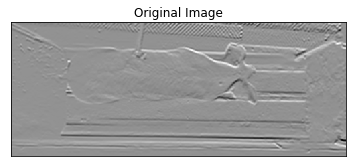

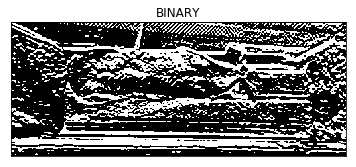

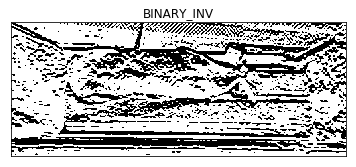

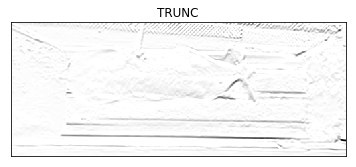

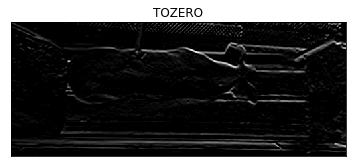

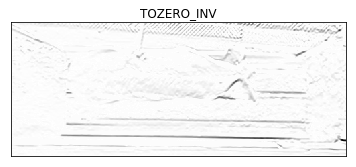

In [130]:
for i in range(6):
    plt.imshow(images[i],'gray')
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([])
    plt.show()

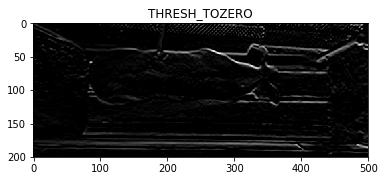

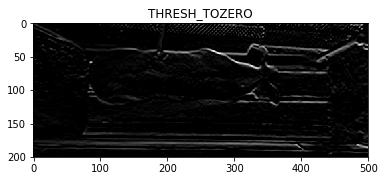

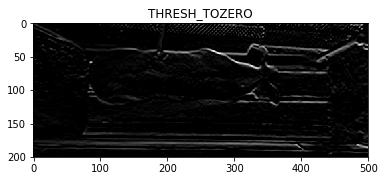

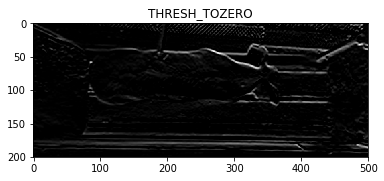

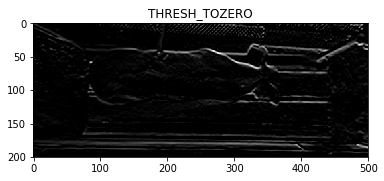

...

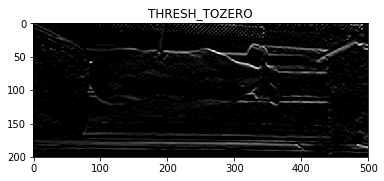

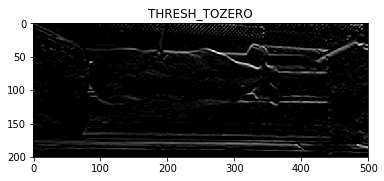

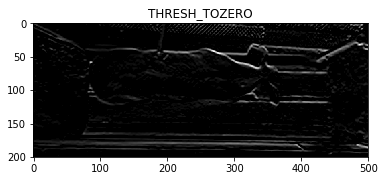

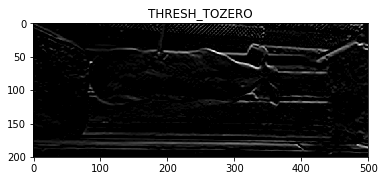

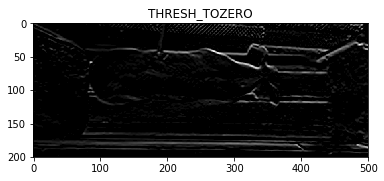

In [133]:
for i in range(20):
    ret, thresh = cv2.threshold(sobely, i*10, 255, cv2.THRESH_TOZERO)
    plt.imshow(thresh, 'gray')
    plt.title('THRESH_TOZERO')
    plt.show()

In [113]:
ret,thresh3 = cv2.threshold(img,110,255,cv2.THRESH_TRUNC)

In [117]:
# thresh3 = cv2.imread('dave.jpg',0)
laplacian = cv2.Laplacian(thresh3,cv2.CV_64F)
sobelx = cv2.Sobel(thresh3,cv2.CV_64F,1,0,ksize=5)
sobely = cv2.Sobel(thresh3,cv2.CV_64F,0,1,ksize=5)

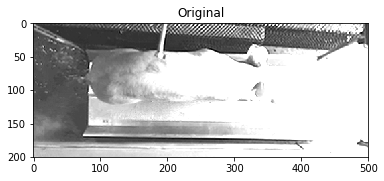

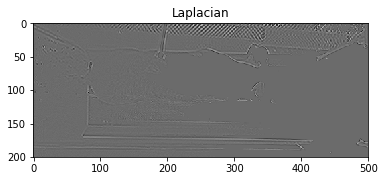

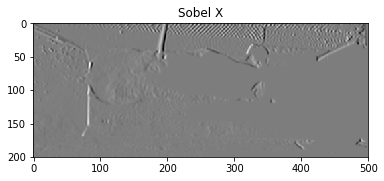

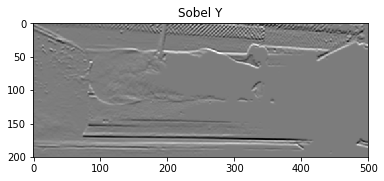

In [119]:
plt.imshow(thresh3,cmap = 'gray')
plt.title('Original')
plt.show()

plt.imshow(laplacian,cmap = 'gray')
plt.title('Laplacian')
plt.show()

plt.imshow(sobelx,cmap = 'gray')
plt.title('Sobel X')
plt.show()

plt.imshow(sobely,cmap = 'gray')
plt.title('Sobel Y')
plt.show()